In [58]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt

import math

In [59]:
df = pd.read_csv('emails.csv')
df.head(5)

,Email No.,the,to,ect,and,for,of,a,you,hou,...,connevey,jay,valued,lay,infrastructure,military,allowing,ff,dry,Prediction
0,Email 1,0,0,1,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Email 2,8,13,24,6,6,2,102,1,27,...,0,0,0,0,0,0,0,1,0,0
2,Email 3,0,0,1,0,0,0,8,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Email 4,0,5,22,0,5,1,51,2,10,...,0,0,0,0,0,0,0,0,0,0
4,Email 5,7,6,17,1,5,2,57,0,9,...,0,0,0,0,0,0,0,1,0,0


In [60]:
df.tail()

,Email No.,the,to,ect,and,for,of,a,you,hou,...,connevey,jay,valued,lay,infrastructure,military,allowing,ff,dry,Prediction
5167,Email 5168,2,2,2,3,0,0,32,0,0,...,0,0,0,0,0,0,0,0,0,0
5168,Email 5169,35,27,11,2,6,5,151,4,3,...,0,0,0,0,0,0,0,1,0,0
5169,Email 5170,0,0,1,1,0,0,11,0,0,...,0,0,0,0,0,0,0,0,0,1
5170,Email 5171,2,7,1,0,2,1,28,2,0,...,0,0,0,0,0,0,0,1,0,1
5171,Email 5172,22,24,5,1,6,5,148,8,2,...,0,0,0,0,0,0,0,0,0,0


Перейдем к очистке данных

Для начала проанализируем датасет на предмет пропусков

Для этого создадим тепловую карту пропусков

<AxesSubplot:>

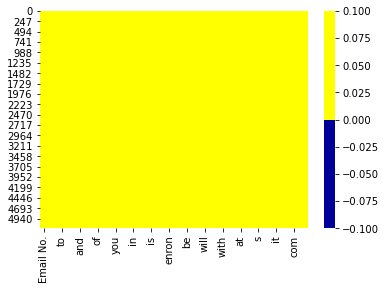

In [61]:
colors = ['#000099','#ffff00']
sns.heatmap(df[df.columns[:30]].isnull(),cmap = sns.color_palette(colors))

Как видно из графика выше, датасет подобран удачно, и пропусков не имеет


Убедимся в отсутствии пропусков

In [62]:
for column in df.columns:
  missing = df[column].isnull()
  if missing.any():
    print("column:", column)
    df['{}_missing'.format(column)] = missing

Взглянем на статистику

In [63]:
df.describe()

,the,to,ect,and,for,of,a,you,hou,in,...,connevey,jay,valued,lay,infrastructure,military,allowing,ff,dry,Prediction
count,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,...,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000,5172.000000
mean,6.640565,6.188128,5.143852,3.075599,3.124710,2.627030,55.517401,2.466551,2.024362,10.600155,...,0.005027,0.012568,0.010634,0.098028,0.004254,0.006574,0.004060,0.914733,0.006961,0.290023
std,11.745009,9.534576,14.101142,6.045970,4.680522,6.229845,87.574172,4.314444,6.967878,19.281892,...,0.105788,0.199682,0.116693,0.569532,0.096252,0.138908,0.072145,2.780203,0.098086,0.453817
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,12.000000,0.000000,0.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.000000,3.000000,1.000000,1.000000,2.000000,1.000000,28.000000,1.000000,0.000000,5.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8.000000,7.000000,4.000000,3.000000,4.000000,2.000000,62.250000,3.000000,1.000000,12.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000
max,210.000000,132.000000,344.000000,89.000000,47.000000,77.000000,1898.000000,70.000000,167.000000,223.000000,...,4.000000,7.000000,2.000000,12.000000,3.000000,4.000000,3.000000,114.000000,4.000000,1.000000


<AxesSubplot:>

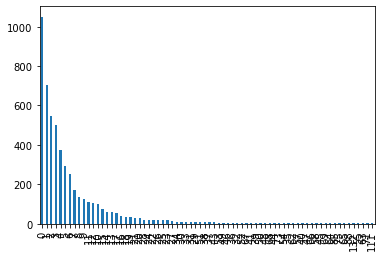

In [64]:
df['to'].value_counts().plot.bar()

In [65]:
# классификация бинарная
df['Prediction'].unique()

array([0, 1])

In [66]:
df.dtypes.unique()

array([dtype('O'), dtype('int64')], dtype=object)

In [67]:
df.select_dtypes(include=['O'])

,Email No.
0,Email 1
1,Email 2
2,Email 3
3,Email 4
4,Email 5
...,...
5167,Email 5168
5168,Email 5169
5169,Email 5170
5170,Email 5171


In [68]:
df = df.drop(columns='Email No.')

In [69]:
# разобьем данные на тренировочные и тестовые
from sklearn.model_selection import train_test_split

# выберем 500 первых строк из датасета, так как иначе кастомный KNN слишком долго обучаются
df = df.iloc[:500,:]
X_train, X_test, y_train, y_test = train_test_split(df.drop(columns='Prediction'), df['Prediction'], test_size=0.2, random_state=42)

In [70]:
class My_knn_with_weights:
    def __init__(self, neighbours):
        self.K = neighbours
    
    def fit(self, X_train, y_train):
        self.X_train = np.array(X_train).copy()
        self.y_train = np.array(y_train).copy()

    def predict(self, X_test):
        X_test = np.array(X_test).copy()
        y_predicted = []
        for row_to_predict in X_test:        
            # расстояния до точек из тренировочной выборки в паре с классом
            dists = []
            for i in range(len(self.X_train)):
                dist = 0
                for j in range(len(self.X_train[i])):
                    dist += pow(row_to_predict[j] - self.X_train[i, j], 2)
                dists.append([math.sqrt(dist), self.y_train[i]])
            # К ближайших соседей
            knn = sorted(dists, key=lambda x: x[0])
            knn = knn[0 : self.K]
            div_dist = list()
            for dist in knn:
                div_dist.append(1/dist[0])
            W = list()
            i = 0
            for n in div_dist:
                W.append([n/sum(div_dist), knn[i][1]])
                i += 1
            unique_classes = np.unique(self.y_train)
            total_probability = {}
            for classs in unique_classes:
                total_probability[classs] = 0
            for weights in W:
                total_probability[weights[1]] += weights[0]
            # максимальная вероятность
            y_predicted.append(max(total_probability, key=total_probability.get))

        y_predicted = np.array(y_predicted)
        return y_predicted

In [71]:
my_knn = My_knn_with_weights(10)
my_knn.fit(X_train, y_train)
y_predicted = my_knn.predict(X_test)
print('Точность моего KNN:')
np.mean((y_predicted) == np.array(y_test))

Точность моего KNN:


0.775

In [72]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors = 10)
knn.fit(X_train, y_train)
y_predicted = knn.predict(X_test)
print('Точность KNN из sklearn:')
np.mean((y_predicted) == np.array(y_test))

Точность KNN из sklearn:


0.7625

In [73]:
class My_naive_Bayes_classifier:
    def probability(self, i, x):
        # вероятность в предположении, что фичи имеют нормальное распределение
        return (1 / np.sqrt(2 * np.pi * self.variances[i])) * \
                    np.exp((-1/2) * (pow(x-self.expectations[i], 2)) / (2 * self.variances[i]))

    # результирующая вероятность
    def result(self, x):
        P = []
        for i in range(self.num_of_classes):
            P.append(np.log(self.p[i]) + np.sum(np.log(self.probability(i, x))))
        predicted_class = self.classes[np.argmax(P)]
        return predicted_class

    def fit(self, X_train, y_train):
        self.classes = np.unique(y_train)
        self.num_of_classes = len(self.classes)
        # матожидания и дисперсии для столбцов таблицы (группируем по классам)
        self.expectations = np.array(X_train.groupby(y_train).apply(np.mean))
        self.variances = np.array(X_train.groupby(y_train).apply(np.var))
        # априорная вероятность того, что рандомная строка принадлежит классу
        self.p = np.array(X_train.groupby(y_train).apply(lambda col: len(col)) / len(y_train))
        
    def predict(self, X_test):
        y_predicted = []
        for x in np.array(X_test):
            y_predicted.append(self.result(x))
        y_predicted = np.array(y_predicted)
        return y_predicted

In [74]:
my_nbc = My_naive_Bayes_classifier()
my_nbc.fit(X_train, y_train)
y_predicted = my_nbc.predict(X_test)
print('Точность моего наивного Байесовского классификатора:')
np.mean((y_predicted) == np.array(y_test))

Точность моего наивного Байесовского классификатора:
/home/vladiq/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/home/vladiq/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
/home/vladiq/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """
/home/vladiq/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in multiply
  """
/home/vladiq/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log
  # This is added back by InteractiveShellApp.init_path()


0.7

In [75]:
from sklearn.naive_bayes import GaussianNB

bayes = GaussianNB() 
bayes.fit(X_train, y_train) 
y_predicted = bayes.predict(X_test)
print('Точность наивного Байесовского классификатора из sklearn:')
bayes.score(X_test, y_test)

Точность наивного Байесовского классификатора из sklearn:


0.9625